In [1]:
# 导包
import numpy as np
import pandas as pd
import os
from sklearn import metrics
from osgeo import gdal
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier as XGBR
from sklearn.model_selection import KFold, cross_val_score as CVS, train_test_split as TTS
from matplotlib import pyplot as plt
from matplotlib.pylab import rcParams
from matplotlib import pyplot as plt
from matplotlib.pylab import rcParams

In [2]:
# 训练并交叉验证
all_csv = '/home/geekplusa/ai/datasets/xraybot/remote_Sensing/result/my/xinjiang_shawan_csv_test.csv'
tool1 = pd.read_csv(all_csv)
a_samples = tool1.iloc[:, :-1]
a_labels = tool1.iloc[:, -1]
a_samples = np.array(a_samples)
a_samples[np.isnan(a_samples)] = 0
classifier = RandomForestClassifier(n_jobs=-1)
classifier.fit(a_samples, a_labels)
# cv=200 0.9234821428571428 cv=500 0.9273333333333332
result_1 = CVS(classifier, a_samples, a_labels, cv=10).mean()

In [14]:
result_1

0.8929577464788734

In [15]:
# 沙湾县数据
predict_csv = '/home/geekplusa/ai/datasets/xraybot/remote_Sensing/result/my/xinjiang_shawan_csv_file_all_data_.csv'
predict_csv_to1 = pd.read_csv(predict_csv)
predict_csv_to1 = predict_csv_to1.iloc[:, :]
predict_csv_to1[np.isinf(predict_csv_to1)] = 10
predict_csv_to1[np.isnan(predict_csv_to1)] = 0
result = classifier.predict(predict_csv_to1)

In [16]:
raster_data_path_1 = "/home/geekplusa/ai/datasets/xraybot/remote_Sensing/result/my/xinjiang_shawan_blue_b2.tif"
raster_data_path_2 = "/home/geekplusa/ai/datasets/xraybot/remote_Sensing/result/my/xinjiang_shawan_green_b3.tif"
raster_data_path_3 = "/home/geekplusa/ai/datasets/xraybot/remote_Sensing/result/my/xinjiang_shawan_red_b4.tif"
raster_data_path_4 = "/home/geekplusa/ai/datasets/xraybot/remote_Sensing/result/my/xinjiang_shawan_nir_b5.tif"

data_list = [raster_data_path_1,raster_data_path_2,raster_data_path_3,raster_data_path_4]

bands_data = []
for i in range(len(data_list)):
    
    raster_dataset = gdal.Open(data_list[i], gdal.GA_ReadOnly)
    geo_transform = raster_dataset.GetGeoTransform()
    proj = raster_dataset.GetProjectionRef()

    band = raster_dataset.GetRasterBand(1)
    bands_data.append(band.ReadAsArray())

    
bands_data = np.dstack(bands_data)
rows, cols, n_bands = bands_data.shape
rows, cols,

(6715, 2986)

In [19]:
classification = result.reshape((rows, cols))
classification

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

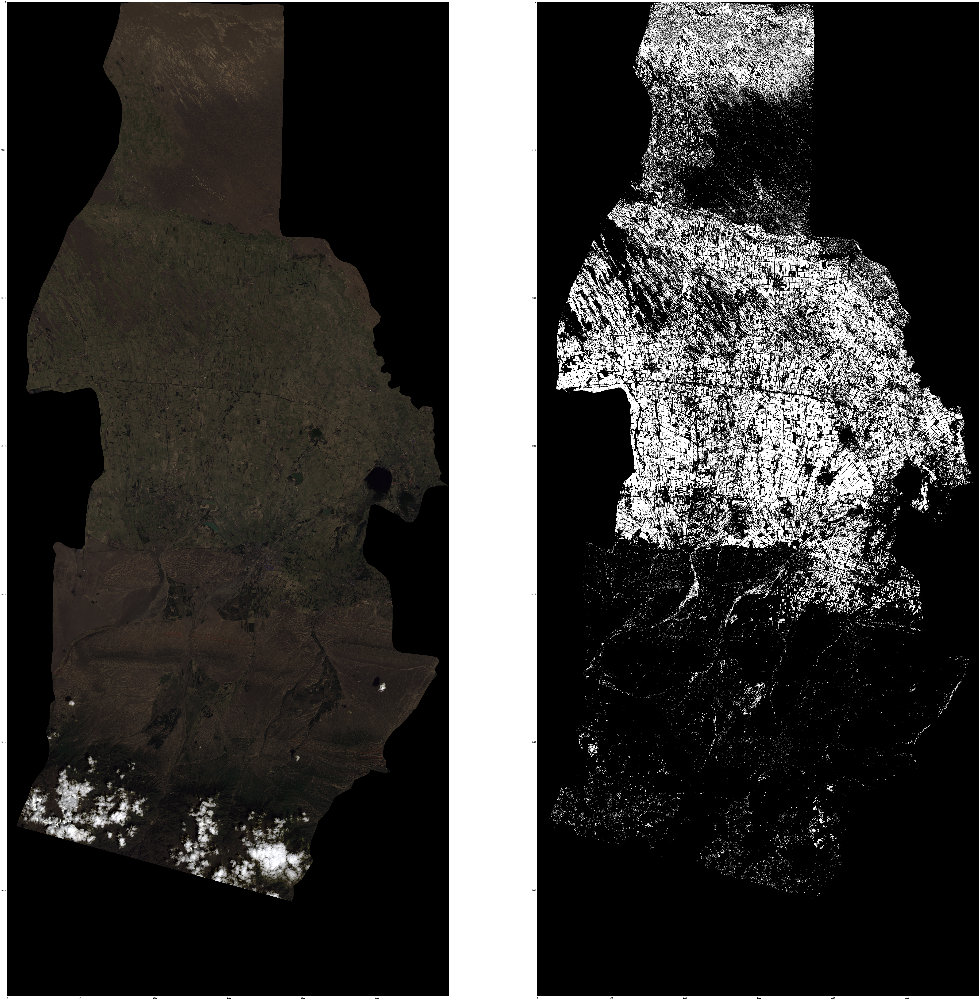

In [56]:
f = plt.figure()
rcParams ['figure.figsize'] = 100, 300
r = bands_data[:,:,2]
g = bands_data[:,:,1]
b = bands_data[:,:,0]
rgb = np.dstack([r,g,b])
f.add_subplot(1, 2, 1)
plt.imshow(rgb/255)
f.add_subplot(1, 2, 2)
plt.imshow(classification,cmap='gray')

In [20]:
aa = classification.reshape(-1)
Sum = 0
for i in range(len(aa)):
    if aa[i] == 1:
        Sum += 1

In [21]:
Sum

3106405